## Shell Cantilever Example

In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
import os
os.environ["MKL_THREADING_LAYER"] = "GNU" # for pardiso: if the kernel crashes, try changing "GNU" to "INTEL"

In [6]:
import numpy as np

import dismech

geom = dismech.GeomParams(rod_r0=0,
                          shell_h=1e-3)

material = dismech.Material(density=1200,
                            youngs_rod=0,
                            youngs_shell=2e8,
                            poisson_rod=0,
                            poisson_shell=0.5)

dynamic_3d_sim = dismech.SimParams(static_sim=False,
                                   two_d_sim=False,
                                   use_mid_edge=True,
                                   use_line_search=False,
                                   show_floor=False,
                                   log_data=True,
                                   log_step=1,
                                   dt=1e-2,
                                   max_iter=25,
                                   total_time=1.0,
                                   plot_step=10,
                                   tol=1e-4,
                                   ftol=1e-4,
                                   dtol=1e-2,
                                   solver='pardiso',
                                   sparse=True)

env = dismech.Environment()
env.add_force('gravity', g=np.array([0.0, 0.0, -9.81]))

geo = dismech.Geometry.from_txt(
    '../tests/resources/shell_cantilever/equilateral_mesh_40.txt')

robot = dismech.SoftRobot(geom, material, geo, dynamic_3d_sim, env)

### Time Stepping

We only need to fix the first few nodes

In [8]:
fixed_points = np.array(np.where(robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)[:, 0] <= 0.01)[0])
robot = robot.fix_nodes(fixed_points)

stepper = dismech.NewmarkBetaTimeStepper(robot)
robots = stepper.simulate()
qs = np.stack([robot.state.q for robot in robots])

  0%|          | 0/100 [00:00<?, ?it/s]

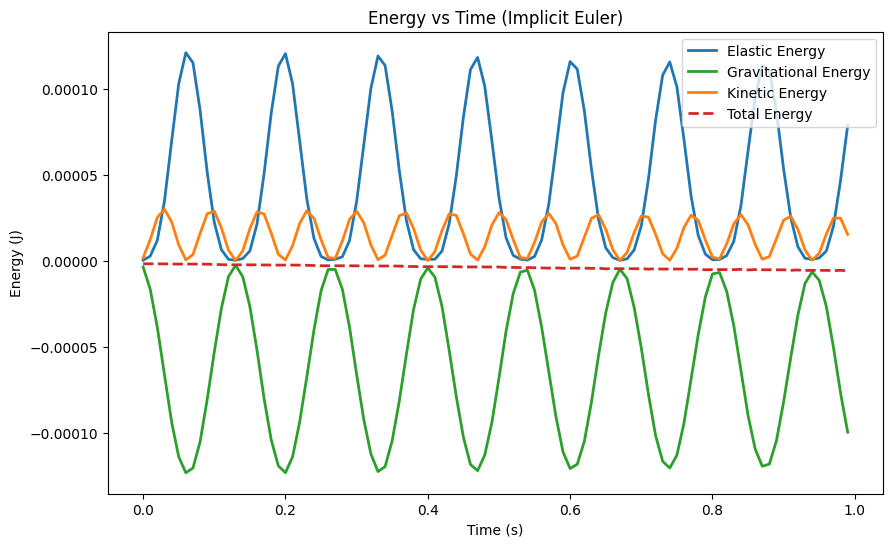

In [ ]:
"""
import matplotlib.pyplot as plt
import dismech.elastics

def get_total_elastic_energy(state):
    return stretch.get_energy_linear_elastic(state) + hinge.get_energy_linear_elastic(state)

def get_graviational_energy(q0, q):
    delq = q - q0
    delq = delq[2:robot.end_node_dof_index:3]
    return np.sum(np.diag(robot.mass_matrix)[2:robot.end_node_dof_index:3] * delq * 9.81)

def get_kinetic_energy(u):
    u_relevant = u[:robot.end_node_dof_index]
    return 0.5 * u_relevant.T @ robot.mass_matrix[:robot.end_node_dof_index, :robot.end_node_dof_index]  @ u_relevant

ee = []
ge = []
ke = []

for robot in robots:
    ee.append(get_total_elastic_energy(robot.state))
    ge.append(get_graviational_energy(robot.q0, robot.state.q))
    ke.append(get_kinetic_energy(robot.state.u))

t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)  # (100)
plt.figure(figsize=(10, 6))
plt.plot(t, ee, label='Elastic Energy', color = '#1f77b4', linewidth=2)
plt.plot(t, ge, label='Gravitational Energy', color = '#2ca02c', linewidth=2)
plt.plot(t, ke, label='Kinetic Energy', color = '#ff7f0e', linewidth=2)
plt.plot(t, np.array(ee) + np.array(ge) + np.array(ke), label='Total Energy', color = '#d62728', linestyle='--', linewidth=2)
plt.xlabel('Time (s)')
plt.ylabel('Energy (J)')
plt.title("Energy vs Time (Implicit Euler)")
plt.legend()
plt.show()
"""
pass

In [9]:
t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)  # (100)
options = dismech.AnimationOptions(z_lim=[-0.015, 0.005],
                                   title='Shell Cantilever (N=40)')
fig = dismech.get_interactive_animation_plotly(robot, t, qs, options)
fig.show()

In [ ]:
#%matplotlib notebook
#from IPython.display import HTML
#options.title = 'Newmark Beta Shell Cantilever (N=40)'
#ani = dismech.get_animation(robot, t, qs, options)
#HTML(ani.to_jshtml())
#ani.save('newmark_beta_shell_cantilever_5s.gif', 'pillow')